In [ ]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

In [63]:
from importlib import reload
import numpy as np
import matplotlib.pyplot as plt
import tifffile as tfl
from sklearn.cluster import KMeans
import cv2

import hsilib as hl
hl = reload(hl)

In [3]:
import spectral.io.envi as envi
hsi_path = r'C:\Users\konst\jupyter_notebook\HSI\data envil\moffet\\'
moffett_hsi = envi.open(hsi_path + r'f080611t01p00r07rdn_c_sc01_ort_img.hdr',
                        hsi_path + r'f080611t01p00r07rdn_c_sc01_ort_img')

HSI = np.array(np.rot90(moffett_hsi.open_memmap(writble = True)))

#HSI = HSI[..., :80]
height, width, bands = HSI.shape

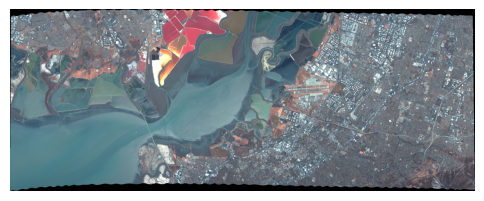

In [4]:
color_image = hl.HSI_to_RGB(HSI, (37, 18, 11))
hl.show(color_image)

In [54]:
reference_coords = np.array((#(540,  470),  #water
                             (508,  428),  #water
                             (288,  758),  #dirt
                             (154,  834),  #swamps
                             (315, 1334),  #soil
                             (335, 1360),  #vegetable
                             (305, 1280),  #concrete
                             (278,  606),  #salt
                             (18,   811),  #salt_water
                             (365, 1431)), #asphalt
                             dtype = int)

name_reference = ("water", "dirt", "swamps", "soil", "vegetable", "concrete", "salt", "salt_water", "asphalt")

colors_class = np.array(((0.56, 0.56, 1), (0.64, 0.28, 0.64), (0.05, 0.54, 0.13), (0.72, 0.45, 0.2),
                        (0, 0.9, 0), (0.29, 0.29, 0.29), (1, 1, 0), (1, 0, 0), (0, 0, 0)))

In [55]:
color_image = hl.HSI_to_RGB(HSI, (37, 18, 11))
reference_pix = hl.calc_ref(reference_coords, HSI, 1)

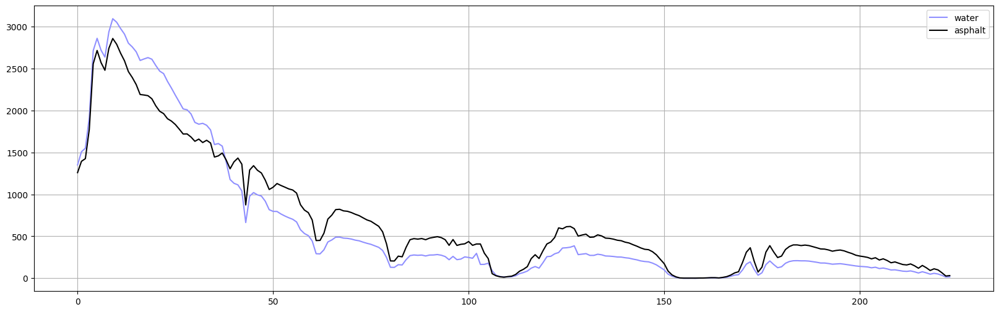

In [56]:
reference_pix
plt.figure(figsize = (20, 6))
for i in (0, 8): #range(reference_coords.shape[0]): #(0, 5):#
    plt.plot(reference_pix[i], color = colors_class[i], label = name_reference[i])
    #plt.hlines(reference_pix[i].mean(), 0, 224, color = colors_class[i])
plt.legend()
plt.grid()
plt.show()

In [72]:
number_of_modes = 24
reference_imfs = hl.EMD(reference_pix, number_of_modes)

обработано 9 пикселей из 9

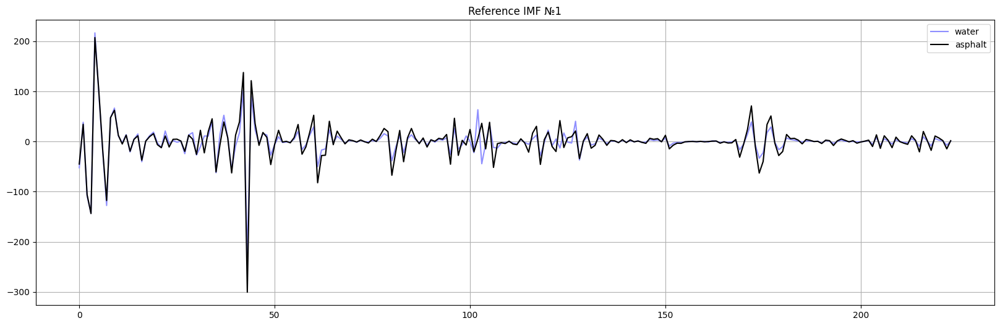

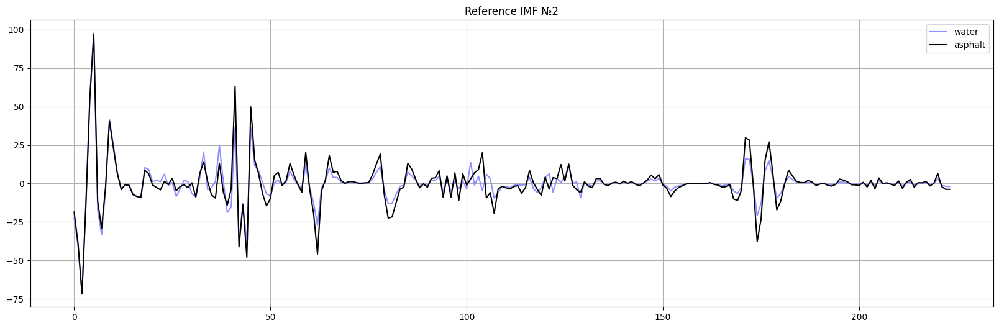

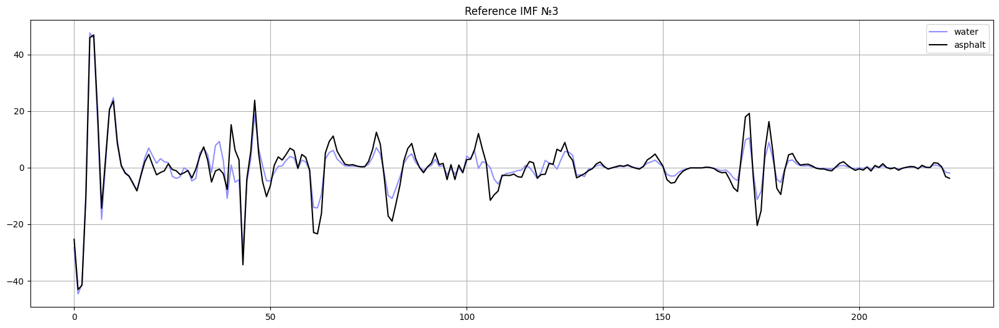

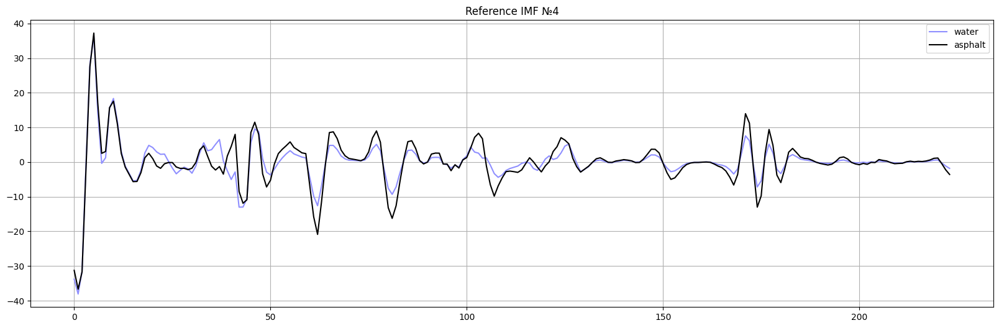

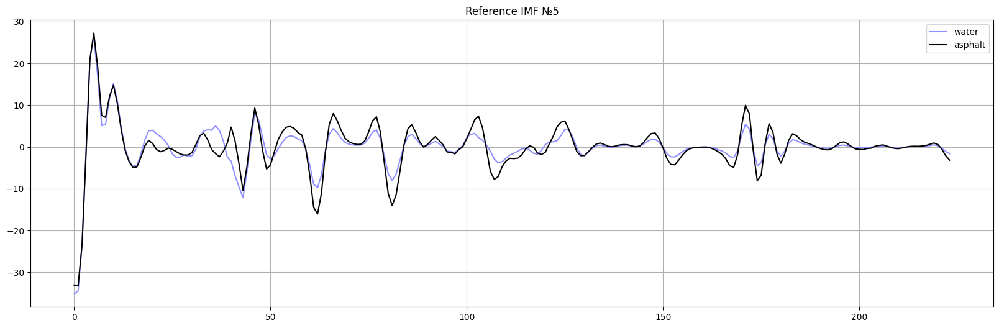

...

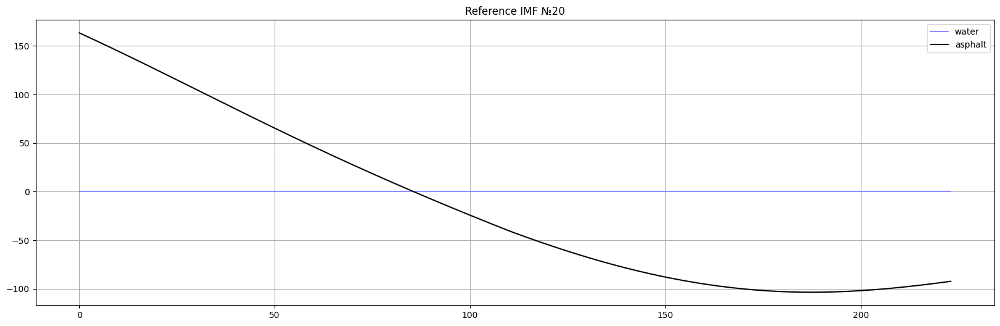

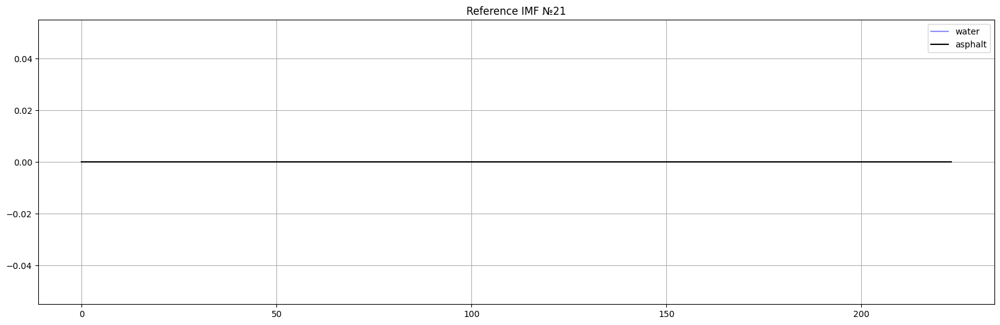

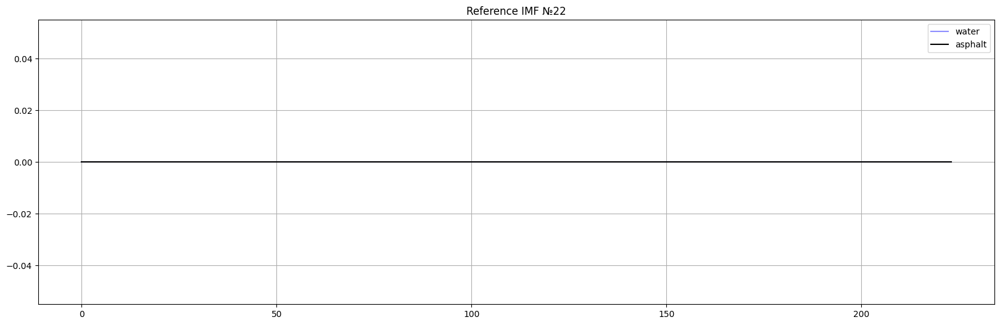

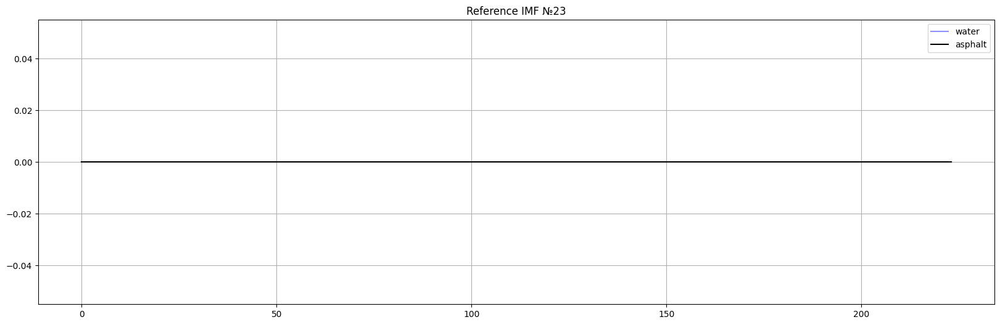

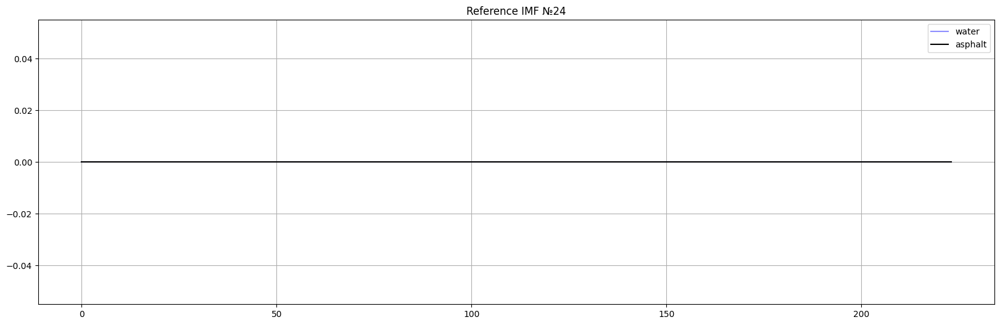

In [73]:
for i in range(number_of_modes):
    reference_pix
    plt.figure(figsize = (20, 6))
    plt.title("Reference IMF №" + str(i + 1))
    for j in (0, 8): #range(reference_imfs.shape[1]):
        plt.plot(reference_imfs[i, j], color = colors_class[j], label = name_reference[j])
    plt.legend()
    plt.grid()
    plt.show()

In [9]:
#IMFs = np.load("12imfs.moffetfield.win(3).npy")

In [64]:
IMFs = hl.EMD(HSI, 6, 12)

обработано 1447601 пикселей из 1448772

In [71]:
IMFs[0, 100, 100]

array([-28.12858582, -21.41547477, -14.69195261,  -8.11498208,
        -1.79673967,   4.15403127,   9.63385356,  14.55540746,
        18.85039654,  22.47192045,  25.39637815,  27.62491568,
        29.81102732,  31.04799218,  31.32393624,  30.65115766,
        29.06499204,  26.62187136,  23.39733511,  19.48275728,
        14.98164192,  10.00609615,   4.75888637,  -0.54490239,
        -5.73216947, -10.6332683 , -15.08687906, -18.94449419,
       -22.07436954, -24.36479698, -25.73597973, -26.14329193,
       -25.57935212, -24.07054906, -21.67604949, -18.48573044,
       -14.61616769, -10.20557133,  -5.40788128,  -0.38625719,
         4.69379025,   9.67071745,  14.39279873,  18.72324071,
        22.54433234,  25.76048808,  28.30011818,  30.11638701,
        31.18694805,  31.51278917,  31.11634858,  30.03907072,
        28.33855571,  26.08543751,  23.36010619,  20.24937686,
        16.84320712,  13.2315711 ,   9.50160242,   5.73510993,
         2.00654572,  -1.61852961,  -5.08447495,  -8.34

# angle KMeans with initial references

In [10]:
def mul_cos_angles(vector1, vector2):
    unit_vector1 = vector1.transpose() / np.linalg.norm(vector1, axis = 1)
    unit_vector2 = vector2.transpose() / np.linalg.norm(vector2, axis = 1)
    
    unit_vector1 = unit_vector1.transpose()
    unit_vector2 = unit_vector2.transpose()
    
    angles = np.zeros(shape = (unit_vector1.shape[0], unit_vector2.shape[0]))
    for i in range(unit_vector2.shape[0]):
        angles[:, i] = unit_vector1.dot(unit_vector2[i])
        
    return angles

In [39]:
def clear_KMeans(imfs, HSI, number_of_clusters = 4, reference = None, max_iters = 50):
    
    HSI = np.reshape(HSI, (HSI.shape[0] * HSI.shape[1], HSI.shape[2]))
    
    height, width, bands = imfs.shape
    imfs = np.reshape(imfs, (height * width, bands))
    
    mask = np.arange(0, imfs.shape[0], dtype = int)
    bool_mask = np.all(HSI == -50, axis = 1)
    mask[bool_mask] = -1
    
    clear_imfs = imfs[mask != -1]
    clear_mask = mask[mask != -1]
    
    #if reference is None:
        #kmeans = KMeans(n_clusters = number_of_clusters, random_state = 0, n_init = "auto").fit(clear_imfs)
    #else:
        #kmeans = KMeans(n_clusters = reference.shape[0], init = reference, n_init = "auto").fit(clear_imfs)
    #centers = kmeans.cluster_centers_
    #clear_labels = kmeans.labels_
    
    centers, clear_labels = do_kmeans(X = clear_imfs, K = 8, init = reference, max_iters = max_iters)
    
    labels = np.zeros(shape = height * width, dtype = int)
    
    for i in range(clear_mask.shape[0]):
        labels[clear_mask[i]] = clear_labels[i] + 1
    
    labels = np.reshape(labels, (height, width))
    
    return centers, labels

In [40]:
def do_kmeans(X, K, init = None, max_iters = 50):
    np.random.seed(42)
    
    # Инициализация центроидов
    
    if init is None:
        centroids = X[np.random.choice(range(len(X)), size = K, replace=False)]
    else:
        centroids = init
    
    for i in range(max_iters):
        # Расчет расстояний между точками и центроидами
        #distances = np.linalg.norm(X[:, np.newaxis] - centroids, axis = 2)
        distances = mul_cos_angles(X, centroids)
        
        # Определение ближайшего центроида для каждой точки
        #labels = np.argmin(distances, axis=1)
        labels = np.argmax(distances, axis=1)
        
        # Обновление центроидов на основе средних значений в каждом кластере
        new_centroids = np.array([X[labels==k].mean(axis=0) for k in range(K)])
        #print(new_centroids)
        
        # Проверка условия сходимости
        if np.all(centroids == new_centroids):
            break
        
        centroids = new_centroids
        
        # Напечатать номер завершённой итерации
        print('\r', end = '')
        print("Итерация № " + str(i + 1), end = '')
        
    print(". Завершено")
        
    return centroids, labels

In [26]:
for n_imf in range(reference_imfs.shape[0]):    
    centers, kmean_labels = clear_KMeans(imfs = IMFs[n_imf], HSI = HSI, reference = reference_imfs[n_imf])
    
    title = "Label map, KMeans, " + str(reference_imfs.shape[1]) + " references, IMF № " + str(n_imf + 1)
    
    plt.figure(figsize = (25, 10))
    plt.imshow(kmean_labels)
    plt.axis("off")
    plt.title(title)
    plt.tight_layout()
    plt.savefig("./image-data/emd-2-ref/angle-KMeans-with-initial-references/labals-map/" + title + ".png")
    plt.close()
    
    kmean_color_label = hl.RGB_labels(color_image, kmean_labels)
    title = "Color map, KMeans, " + str(reference_imfs.shape[1]) + " references, IMF № " + str(n_imf + 1)
    
    plt.figure(figsize = (25, 10))
    plt.imshow(kmean_color_label)
    plt.axis("off")
    plt.title(title)
    plt.tight_layout()
    plt.savefig("./image-data/emd-2-ref/angle-KMeans-with-initial-references/colors-map/" + title + ".png")
    plt.close()

Итерация № 46. Завершено
Итерация № 35. Завершено
Итерация № 29. Завершено
Итерация № 50. Завершено
Итерация № 39. Завершено
Итерация № 30. Завершено
Итерация № 21. Завершено
Итерация № 46. Завершено
Итерация № 49. Завершено
Итерация № 50. Завершено
Итерация № 50. Завершено
Итерация № 50. Завершено


# 4 + 12 imf

In [30]:
sum_imf = IMFs[3] + IMFs[11]

In [34]:
sum_reference_imfs = reference_imfs[3] + reference_imfs[11]

Итерация № 94. Завершено


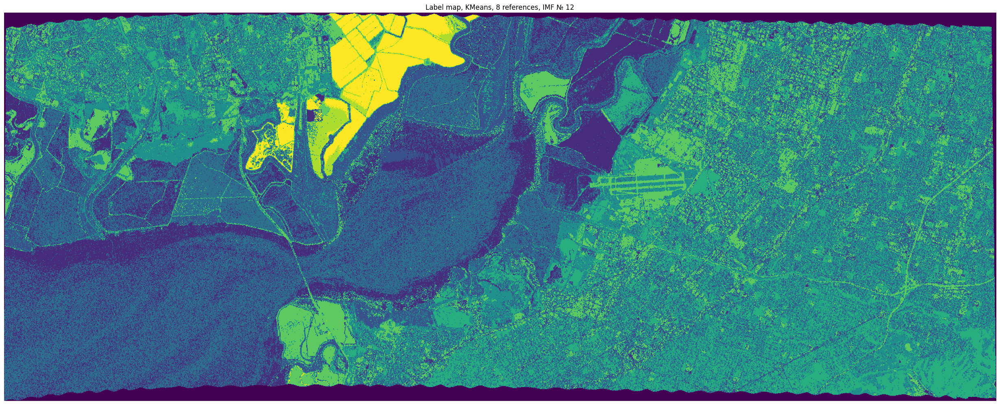

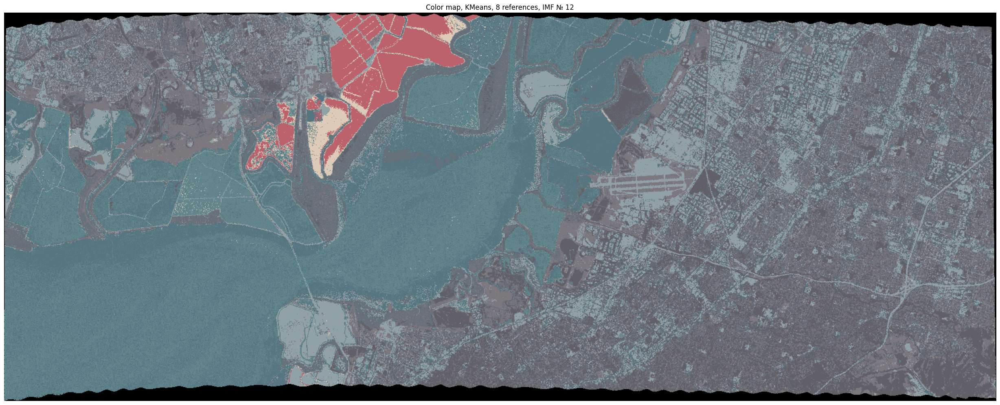

In [41]:
centers, kmean_labels = clear_KMeans(imfs = sum_imf, HSI = HSI, reference = sum_reference_imfs, max_iters = 150)

title = "Label map, KMeans, " + str(reference_imfs.shape[1]) + " references, IMF № " + str(n_imf + 1)

plt.figure(figsize = (25, 10))
plt.imshow(kmean_labels)
plt.axis("off")
plt.title(title)
plt.tight_layout()
plt.show()
#plt.savefig("./image-data/emd-2-ref/angle-KMeans-with-initial-references/labals-map/" + title + ".png")
#plt.close()

kmean_color_label = hl.RGB_labels(color_image, kmean_labels)
title = "Color map, KMeans, " + str(reference_imfs.shape[1]) + " references, IMF № " + str(n_imf + 1)

plt.figure(figsize = (25, 10))
plt.imshow(kmean_color_label)
plt.axis("off")
plt.title(title)
plt.tight_layout()
plt.show()
#plt.savefig("./image-data/emd-2-ref/angle-KMeans-with-initial-references/colors-map/" + title + ".png")
#plt.close()

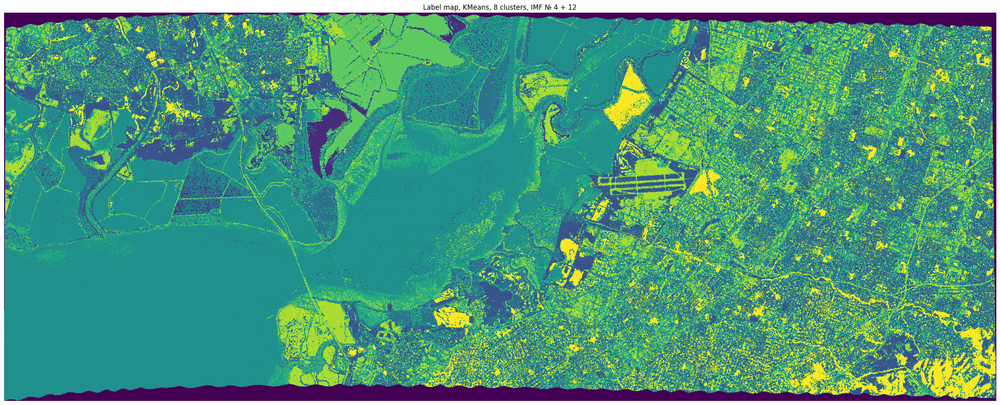

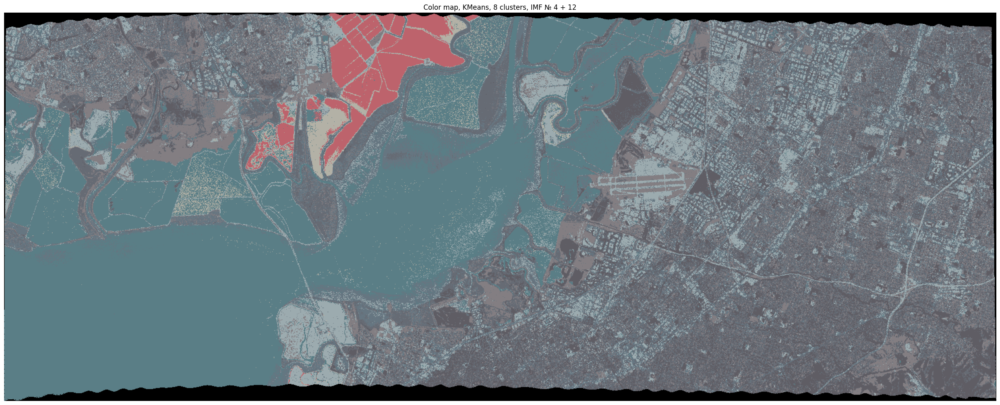

In [43]:
number_of_clusters = 8
centers, kmean_labels = clear_KMeans(imfs = sum_imf, HSI = HSI, number_of_clusters = number_of_clusters, max_iters = 150)

title = "Label map, KMeans, " + str(number_of_clusters) + " clusters, IMF № 4 + 12"

plt.figure(figsize = (25, 10))
plt.imshow(kmean_labels)
plt.axis("off")
plt.title(title)
plt.tight_layout()
plt.show()

kmean_color_label = hl.RGB_labels(color_image, kmean_labels)
title = "Color map, KMeans, " + str(number_of_clusters) + " clusters, IMF № 4 + 12"

plt.figure(figsize = (25, 10))
plt.imshow(kmean_color_label)
plt.axis("off")
plt.title(title)
plt.tight_layout()
plt.show()

# 17 imf

In [84]:
centers, kmean_labels = clear_KMeans(imfs = IMFs[4], HSI = HSI, reference = reference_imfs[16], max_iters = 50)

C:\Users\konst\AppData\Local\Temp\ipykernel_20116\3001325670.py:25: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if np.all(centroids == new_centroids):


Итерация № 50. Завершено


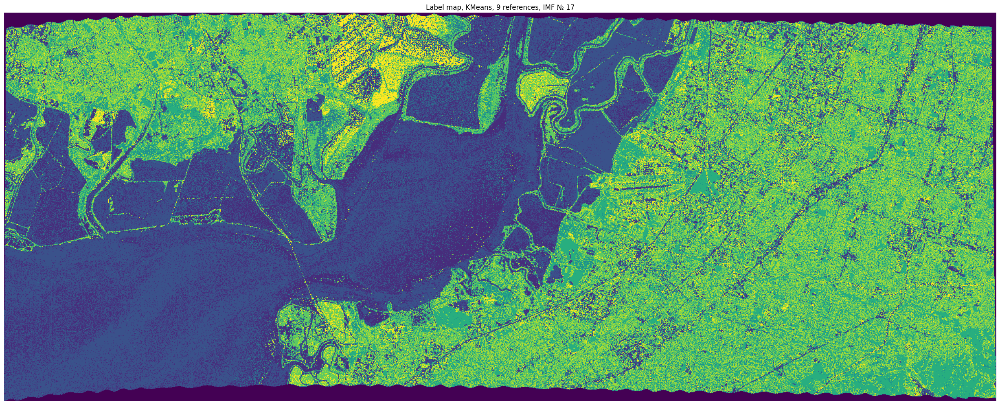

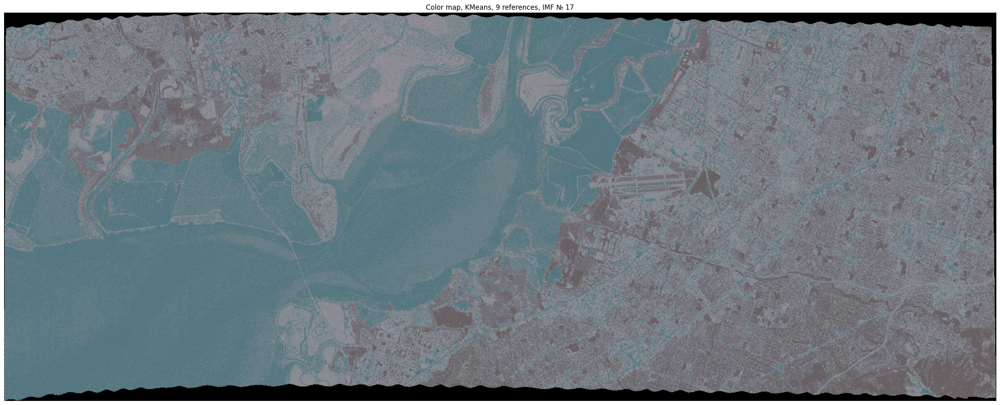

In [85]:
title = "Label map, KMeans, " + str(reference_imfs.shape[1]) + " references, IMF № 17"

plt.figure(figsize = (25, 10))
plt.imshow(kmean_labels)
plt.axis("off")
plt.title(title)
plt.tight_layout()
plt.show()

kmean_color_label = hl.RGB_labels(color_image, kmean_labels)
title = "Color map, KMeans, " + str(reference_imfs.shape[1]) + " references, IMF № 17"

plt.figure(figsize = (25, 10))
plt.imshow(kmean_color_label)
plt.axis("off")
plt.title(title)
plt.tight_layout()
plt.show()

In [49]:

cv2.imwrite(r"C:\Users\konst\Desktop\rgb_hsi.png", cv2.cvtColor(color_image, cv2.COLOR_RGB2BGR))

True

In [48]:
?cv2.cvtColor